# Gráficas 


En este Jupyter Notebook, realizamos las gráficas de las predicciones hechas. Tmabién creamos las tablas que irán en la memoria del TFM. 

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import os

## Lectura de datos 

In [20]:
# Nombre de las acciones
tickers = [
    'TSCO', 'AZN', 'BARC', 'BP', 'BATS', 'HLMA',
    'HSBA', 'JMAT', 'LGEN', 'MKS', 'PSON', 'REL',
    'NWG', 'SHEL', 'SGE', 'SBRY', 'SDR', 'SVT',
    'SMIN', 'SSE', 'VOD'
]

modelos_name = ['base', 'RAF', 'SVM'] 

#for ticker in tickers: 
#    for j in range(20): 
#        print(f'predicciones_{ticker}_Bloque_{j}.csv')


In [21]:
modelo = 'base'
#ticker = 'AZN'
#bloque = 'Bloque_0'



carpeta_predicciones = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{modelo}')
print(carpeta_predicciones)
print()

for ticker in tickers: 
    for j in range(20): 
        # Leo archivo csv que contiene resultados 
        archivo = f'predicciones_{ticker}_Bloque_{j}.csv'
        ruta_archivo = os.path.join(carpeta_predicciones, archivo)
        #print(ruta_archivo)



#carperta_metricas =

C:\Users\Usuario\Desktop\TFM\Codigos python\resultados_predicciones\modelo_base



In [22]:
def grafica_predicciones_retorno(models, accion_name, bloque_name, xlim=None, legend=True):
    '''
    model : lista de strings con los modelos que queramos graficar. ['base', 'RAF', 'SVM', 'DNN', 'LSTM']
    '''
    
    # Archivo que contiene las predicciones de accion_name y bloque_name
    archivo = f'predicciones_{accion_name}_{bloque_name}.csv'
    
    # Guardo el y_test (común a todos los modelos)
    ruta = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{models[0]}', archivo)
    y_test = pd.read_csv(ruta)['y_test'].values
    print(len(y_test))
    
    # Creo la figura y grafico y_test
    fig, ax = plt.subplots()
    ax.plot(y_test, color='black', label = 'y_test') 
    
    # Bucle para todos los modelos que queramos graficar 
    for model in models: 

        carpeta_predicciones = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{model}')
        ruta_archivo = os.path.join(carpeta_predicciones, archivo)
        df = pd.read_csv(ruta_archivo)
        #print(ruta_archivo)
        #display(df.head())
        y_pred = df['y_pred']
    
        # Grafico los retornos
        ax.plot(y_pred, label = f'Modelo {model}')
        
        if xlim:
            ax.set_xlim(xlim)
            
        if legend: 
            plt.legend()
            
    plt.title(f'{bloque_name}')
    
    return


In [23]:
def grafica_predicciones_precio(models, accion_name, bloque_name, xlim=None, legend=True):
    '''
    model : lista de strings con los modelos que queramos graficar. ['base', 'RAF', 'SVM', 'DNN', 'LSTM']
    '''
    
    # Archivo que contiene las predicciones de accion_name y bloque_name
    archivo = f'predicciones_{accion_name}_{bloque_name}.csv'
    
    # Guardo el y_test (común a todos los modelos)
    ruta = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{models[0]}', archivo)
    y_test = pd.read_csv(ruta)['y_test_close'].values
    print(len(y_test))
    
    # Creo la figura y grafico y_test
    fig, ax = plt.subplots()
    ax.plot(y_test, color='black', label = 'y_test_close') # El primer y_test (750) no lo 
    
    # Bucle para todos los modelos que queramos graficar 
    for model in models: 

        carpeta_predicciones = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{model}')
        ruta_archivo = os.path.join(carpeta_predicciones, archivo)
        df = pd.read_csv(ruta_archivo)
        #print(ruta_archivo)
        #display(df.head())
        y_pred_close  = df['y_pred_close']
    

        # Grafico los precios
        ax.plot(y_pred_close, label = f'Modelo {model}')
        
        if xlim:
            ax.set_xlim(xlim)
            
        if legend: 
            plt.legend()
            
    plt.title(f'{bloque_name}')
    
    return

250
250
250


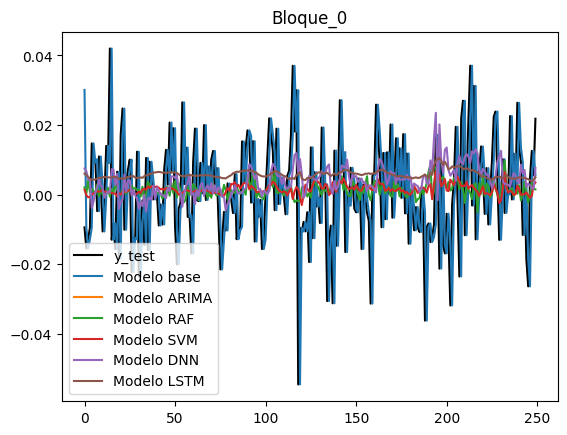

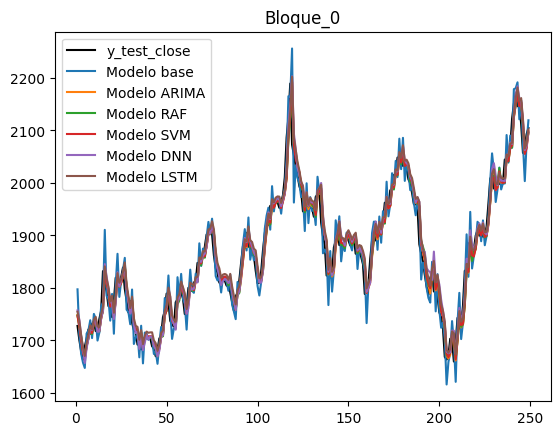

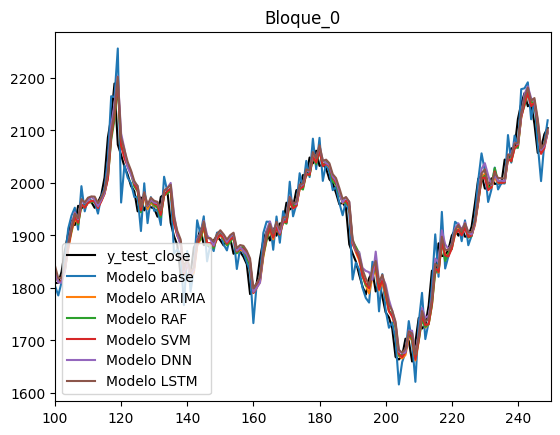

In [55]:
modelo = 'base'
ticker = 'AZN'
bloque = 'Bloque_0'

grafica_predicciones_retorno(['base', 'ARIMA', 'RAF', 'SVM', 'DNN', 'LSTM'], ticker, bloque)
grafica_predicciones_precio(['base', 'ARIMA', 'RAF', 'SVM', 'DNN', 'LSTM'], ticker, bloque)
grafica_predicciones_precio(['base', 'ARIMA', 'RAF', 'SVM', 'DNN', 'LSTM'], ticker, bloque, xlim=[100,250])


### Grafico todos los bloques 


In [28]:

def grafica_predicciones_retorno2(models, accion_name, bloque_name, ax, xlim=None, legend=True):
    '''
    model : lista de strings con los modelos que queramos graficar. ['base', 'RAF', 'SVM', 'DNN', 'LSTM']
    '''
    
    # Archivo que contiene las predicciones de accion_name y bloque_name
    archivo = f'predicciones_{accion_name}_{bloque_name}.csv'
    
    # Guardo el y_test (común a todos los modelos)
    ruta = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{models[0]}', archivo)
    y_test = pd.read_csv(ruta)['y_test'].values
    
    # NO CREO FIGURA
    
    ax.plot(y_test, color='black', label = 'y_test') 
    
    # Bucle para todos los modelos que queramos graficar 
    for model in models: 

        carpeta_predicciones = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{model}')
        ruta_archivo = os.path.join(carpeta_predicciones, archivo)
        df = pd.read_csv(ruta_archivo)
        #print(ruta_archivo)
        #display(df.head())
        y_pred = df['y_pred']
    

        # Grafico los retornos
        ax.plot(y_pred, label = f'Modelo {model}')
        
        if xlim:
            ax.set_xlim(xlim)
            
        if legend: 
            ax.legend()
            
    ax.set_title(f'{bloque_name}')
    
    return

In [29]:

def grafica_predicciones_precio2(models, accion_name, ax, bloque_name, xlim=None, legend=True):
    '''
    model : lista de strings con los modelos que queramos graficar. ['base', 'RAF', 'SVM', 'DNN', 'LSTM']
    '''
    
    # Archivo que contiene las predicciones de accion_name y bloque_name
    archivo = f'predicciones_{accion_name}_{bloque_name}.csv'
    
    # Guardo el y_test (común a todos los modelos)
    ruta = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{models[0]}', archivo)
    y_test = pd.read_csv(ruta)['y_test_close'].values
    
    # Creo la figura y grafico y_test
    ax.plot(y_test, color='black', label = 'y_test_close') # El primer y_test (750) no lo 
    
    # Bucle para todos los modelos que queramos graficar 
    for model in models: 

        carpeta_predicciones = os.path.join(os.getcwd(), 'resultados_predicciones', f'modelo_{model}')
        ruta_archivo = os.path.join(carpeta_predicciones, archivo)
        df = pd.read_csv(ruta_archivo)
        #print(ruta_archivo)
        #display(df.head())
        y_pred_close  = df['y_pred_close']
        

        # Grafico los precios
        ax.plot(y_pred_close, label = f'Modelo {model}')
        
        if xlim:
            ax.set_xlim(xlim)
            
        if legend: 
            ax.legend()
            
    ax.set_title(f'{bloque_name}')
    
    return

Funciones que grafican 5x4 figura

In [30]:

def grafica_predicciones_multiple_retorno(accion_name, models, n_bloques=20):
    fig, axs = plt.subplots(5, 4, figsize=(20, 15))
    axs = axs.flatten()

    for i in range(n_bloques):
        bloque_name = f'bloque_{i}'  # Ajustar si tus bloques tienen otro formato
        grafica_predicciones_retorno2(
            models=models,
            accion_name=accion_name,
            bloque_name=bloque_name,
            ax=axs[i],
            legend=False  # quitamos leyenda por subplot
        )
    
    # Leyenda global
    handles, labels = axs[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=len(models)+1)

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    
    # ==========================
    #   GUARDAR LA FIGURA
    # ==========================
    carpeta = os.path.join(os.getcwd(), 'imagenes')   # Ruta a la carpeta (ya creada)
    nombre_archivo = f"{accion_name}_predicciones_5x4.png"
    ruta_guardado = os.path.join(carpeta, nombre_archivo)

    fig.savefig(ruta_guardado, dpi=300, bbox_inches='tight')  # <--- AQUÍ SE GUARDA
    print(f"Imagen guardada en: {ruta_guardado}")
    
    plt.show()
    

In [31]:
def grafica_predicciones_multiple_precio(accion_name, models, n_bloques=20):
    fig, axs = plt.subplots(5, 4, figsize=(20, 15))
    axs = axs.flatten()

    for i in range(n_bloques):
        bloque_name = f'bloque_{i}'  # Ajustar si tus bloques tienen otro formato
        grafica_predicciones_precio2(
            models=models,
            accion_name=accion_name,
            bloque_name=bloque_name,
            ax=axs[i],
            legend=False  # quitamos leyenda por subplot
        )
    
    # Leyenda global
    handles, labels = axs[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', ncol=len(models)+1)

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    
    # ==========================
    #   GUARDAR LA FIGURA
    # ==========================
    carpeta = os.path.join(os.getcwd(), 'imagenes')   # Ruta a la carpeta (ya creada)
    nombre_archivo = f"{accion_name}_predicciones_precio_5x4.png"
    ruta_guardado = os.path.join(carpeta, nombre_archivo)

    fig.savefig(ruta_guardado, dpi=300, bbox_inches='tight')  # <--- AQUÍ SE GUARDA
    print(f"Imagen guardada en: {ruta_guardado}")
    
    plt.show()

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\AZN_predicciones_5x4.png


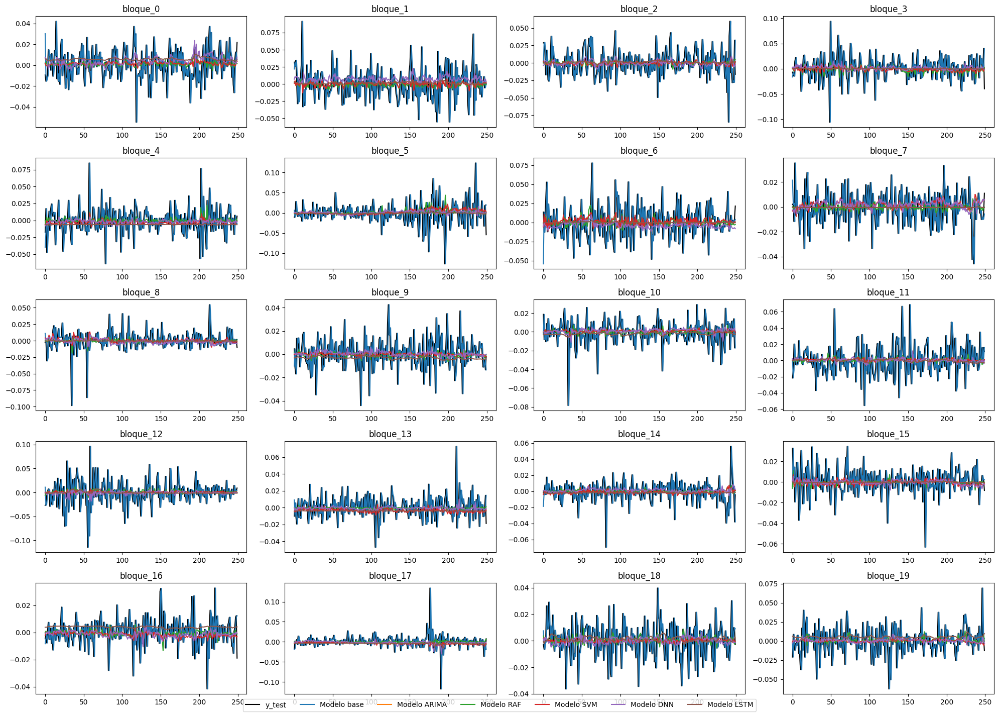

In [48]:
grafica_predicciones_multiple_retorno('AZN', models=['base','ARIMA','RAF','SVM', 'DNN', 'LSTM'])

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\AZN_predicciones_precio_5x4.png


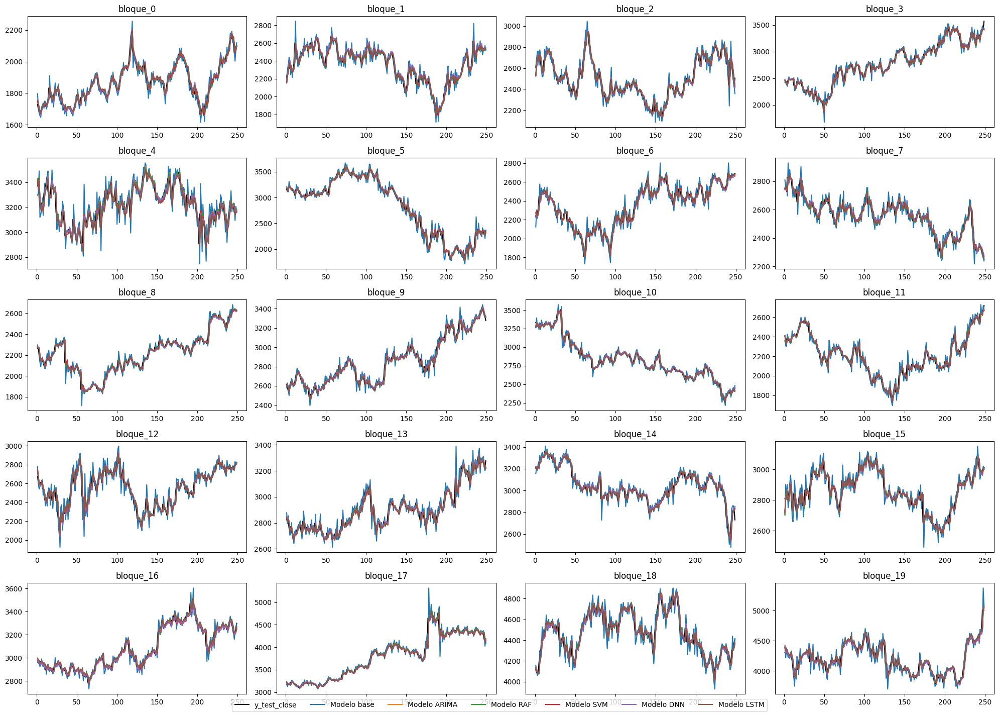

In [49]:
grafica_predicciones_multiple_precio('AZN', models=['base','ARIMA','RAF','SVM', 'DNN', 'LSTM'])

In [ ]:
accion_name = 'AZN'
bloque_name = 'Bloque_0'

grafica_predicciones_precio2(
            models=models,
            accion_name=accion_name,
            bloque_name=bloque_name,
            ax=axs[i],
            legend=False  # quitamos leyenda por subplot
        )

In [63]:
# Nombre de las acciones
tickers = [
    'TSCO', 'AZN', 'BARC', 'BP', 'BATS', 'HLMA',
    'HSBA', 'JMAT', 'LGEN', 'MKS', 'PSON', 'REL',
    'NWG', 'SHEL', 'SGE', 'SBRY', 'SDR', 'SVT',
    'SMIN', 'SSE', 'VOD'
]

data_frames = {} # Inicializo diciconario de data frames

for ticker in tickers: 
    
    df = pd.read_csv(f'datasets_features/{ticker}.csv')  # leo el dataset
    data_frames[ticker] = df                             # guardo dataframes
    
print(data_frames.keys())

dict_keys(['TSCO', 'AZN', 'BARC', 'BP', 'BATS', 'HLMA', 'HSBA', 'JMAT', 'LGEN', 'MKS', 'PSON', 'REL', 'NWG', 'SHEL', 'SGE', 'SBRY', 'SDR', 'SVT', 'SMIN', 'SSE', 'VOD'])


Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\TSCO_predicciones_precio_5x4.png


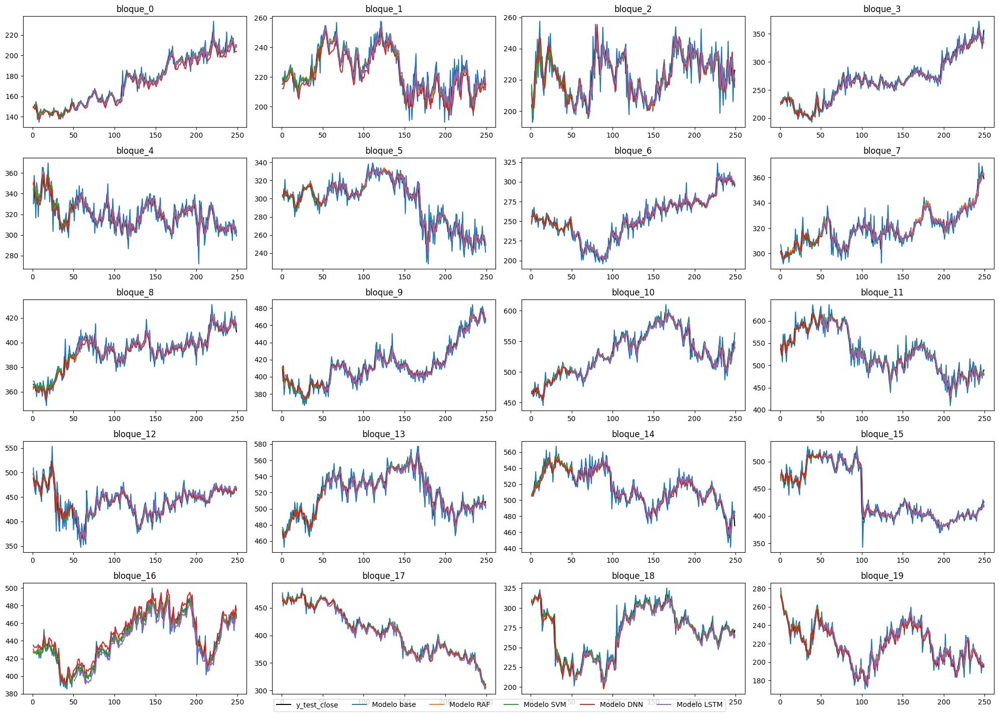

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\AZN_predicciones_precio_5x4.png


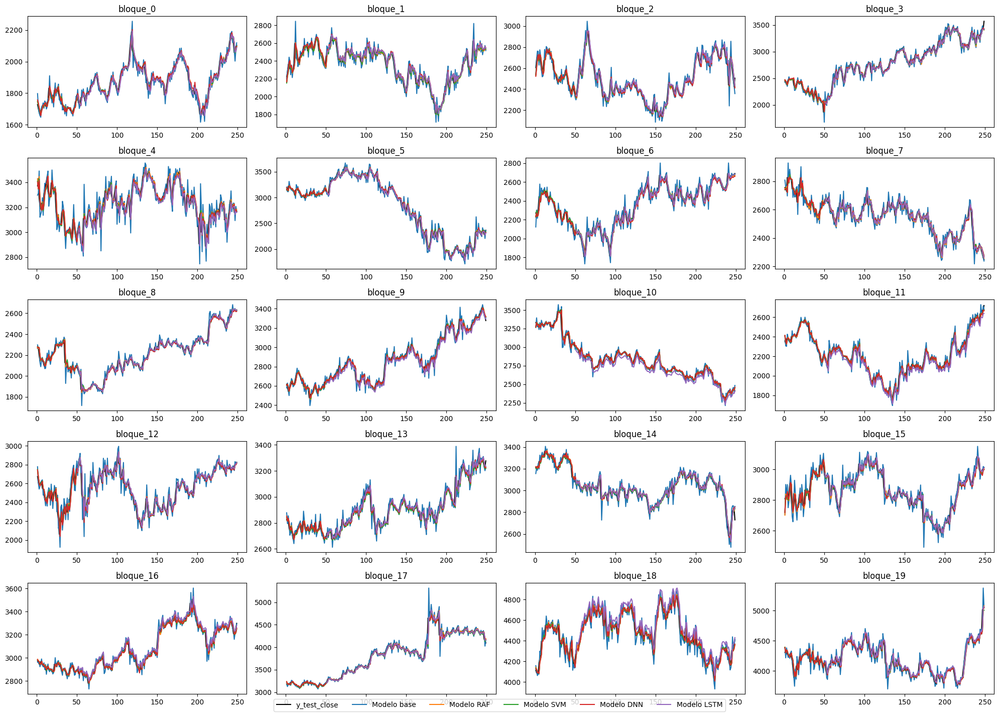

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\BARC_predicciones_precio_5x4.png


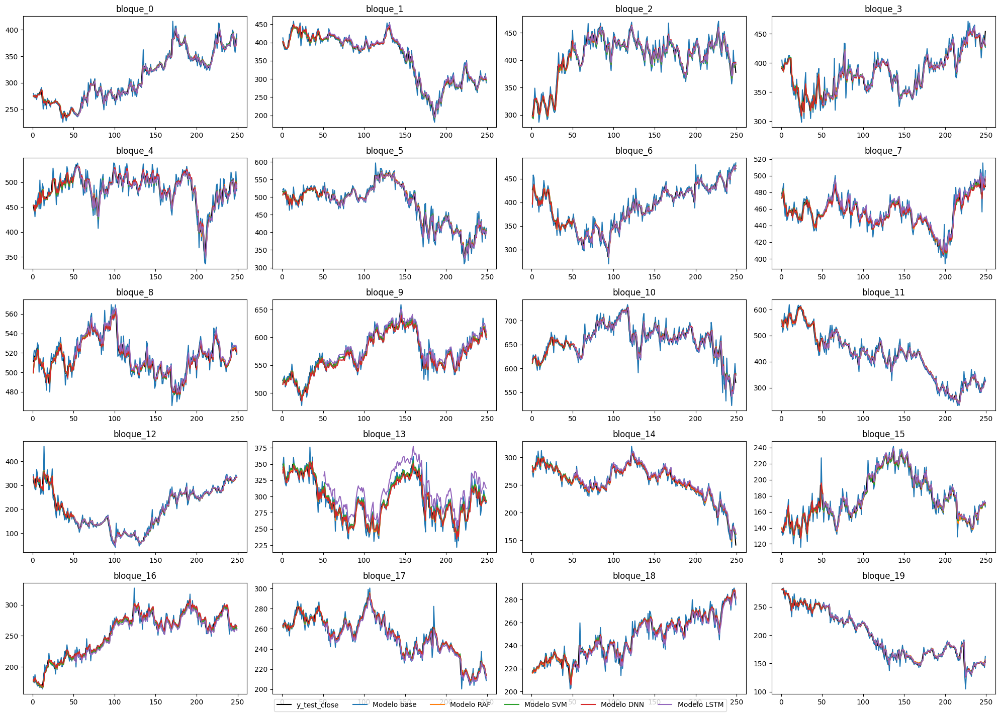

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\BP_predicciones_precio_5x4.png


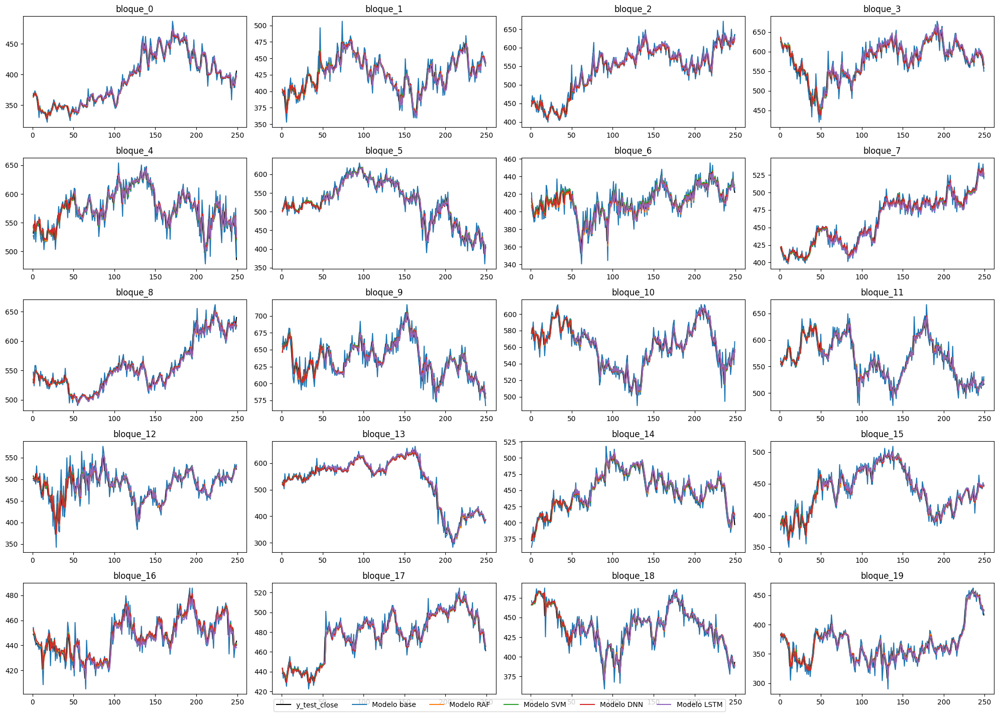

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\BATS_predicciones_precio_5x4.png


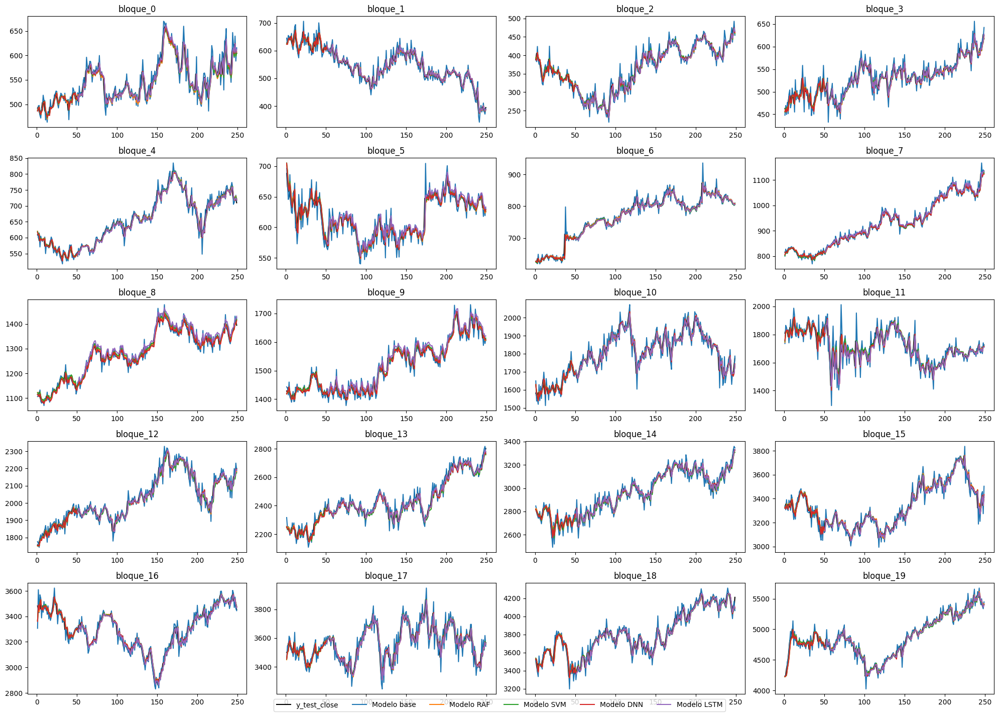

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\HLMA_predicciones_precio_5x4.png


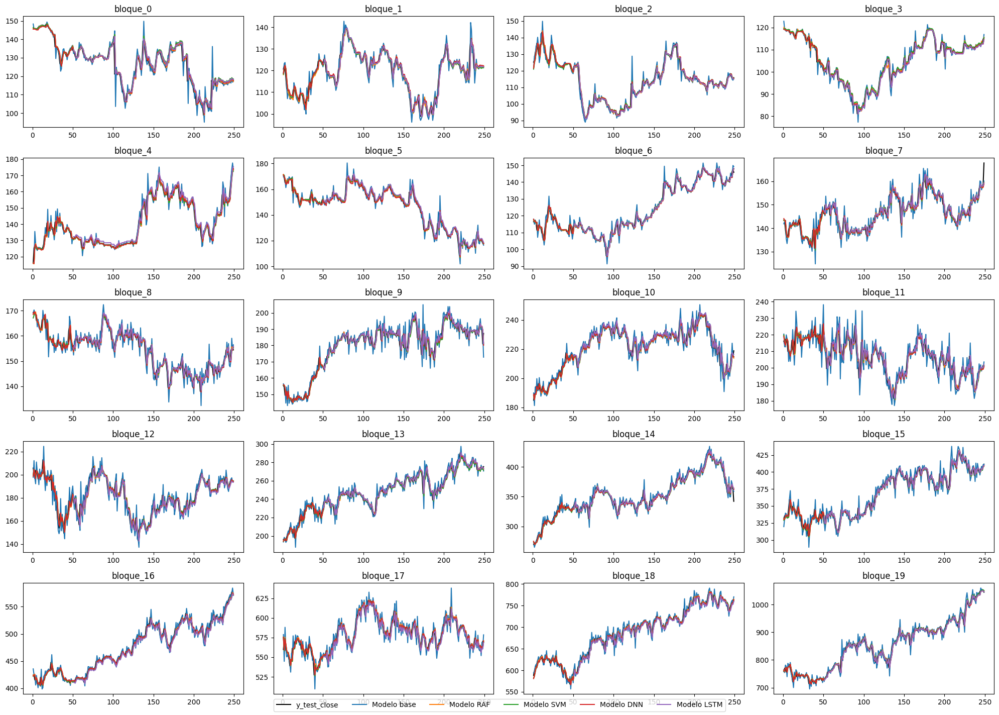

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\HSBA_predicciones_precio_5x4.png


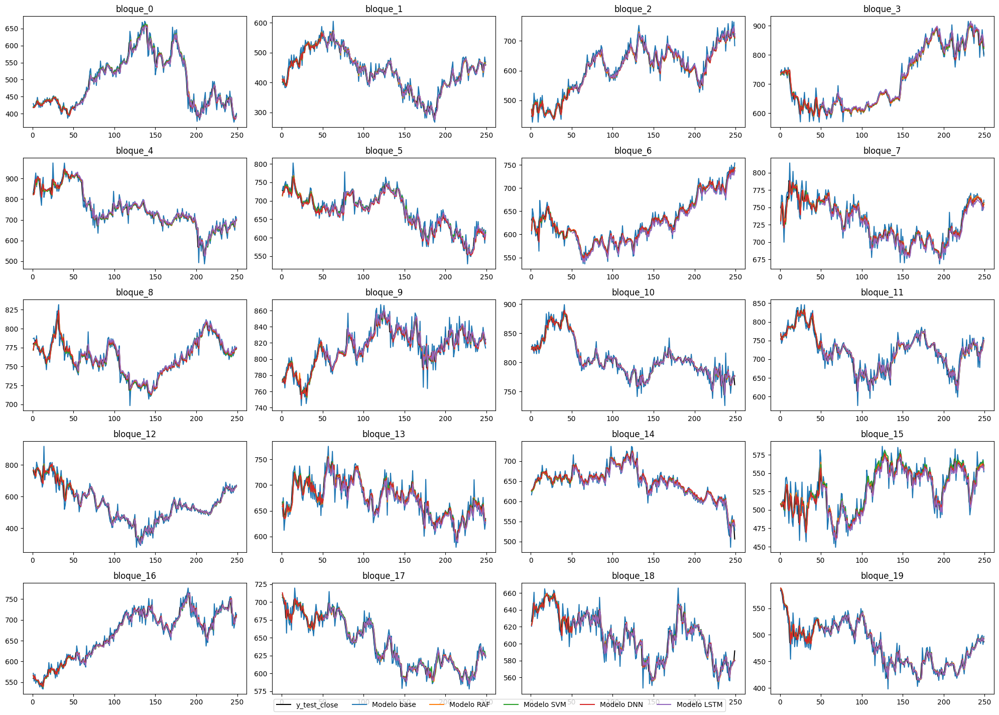

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\JMAT_predicciones_precio_5x4.png


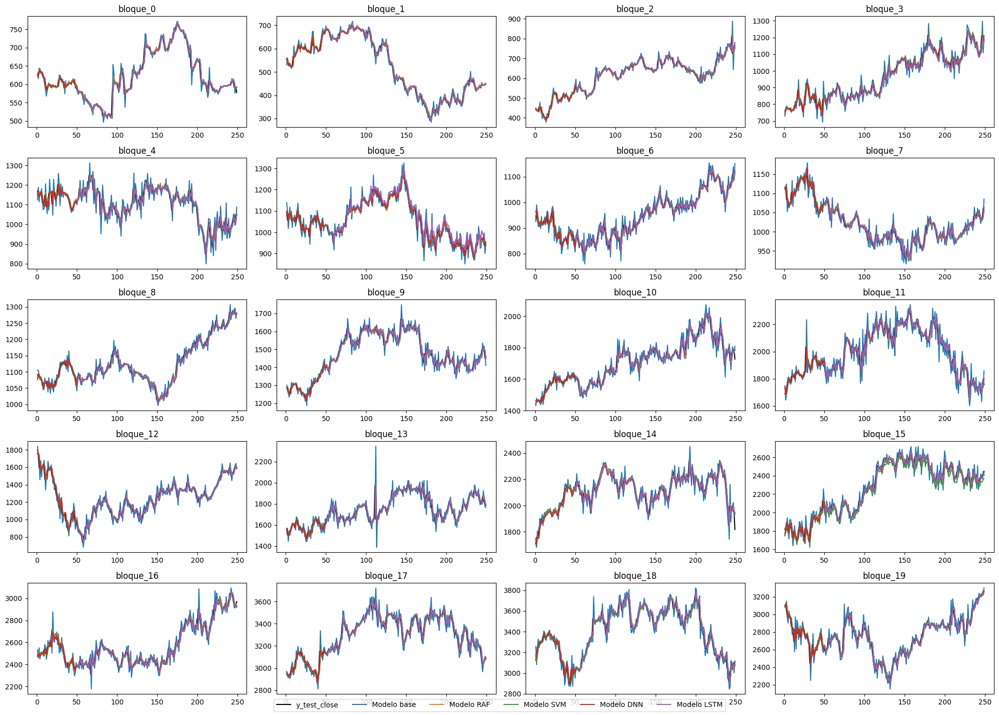

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\LGEN_predicciones_precio_5x4.png


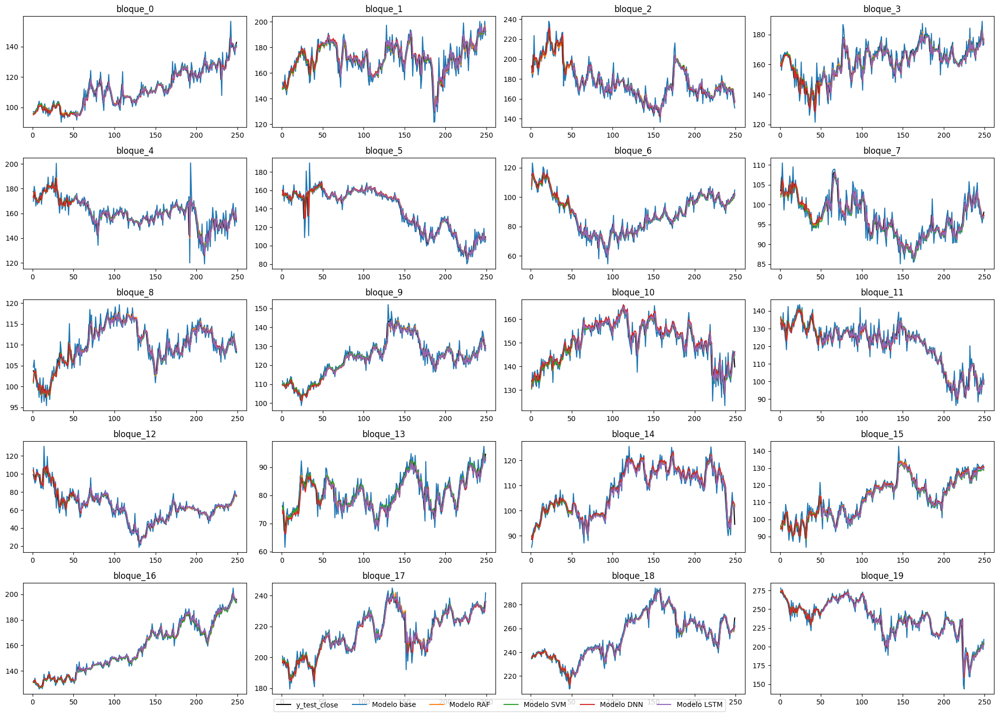

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\MKS_predicciones_precio_5x4.png


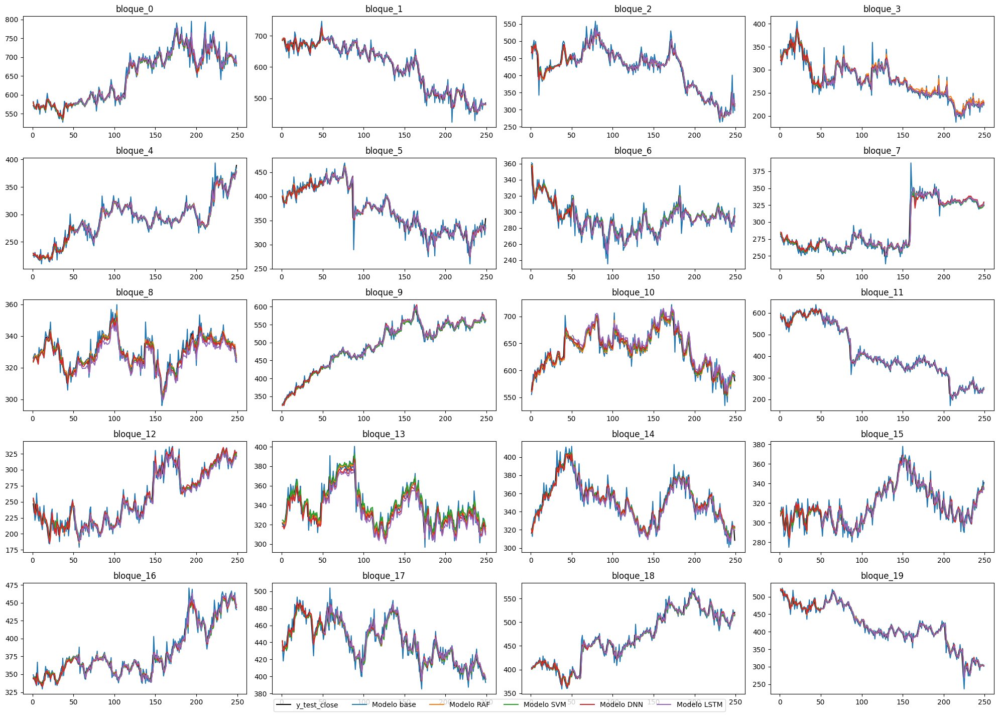

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\PSON_predicciones_precio_5x4.png


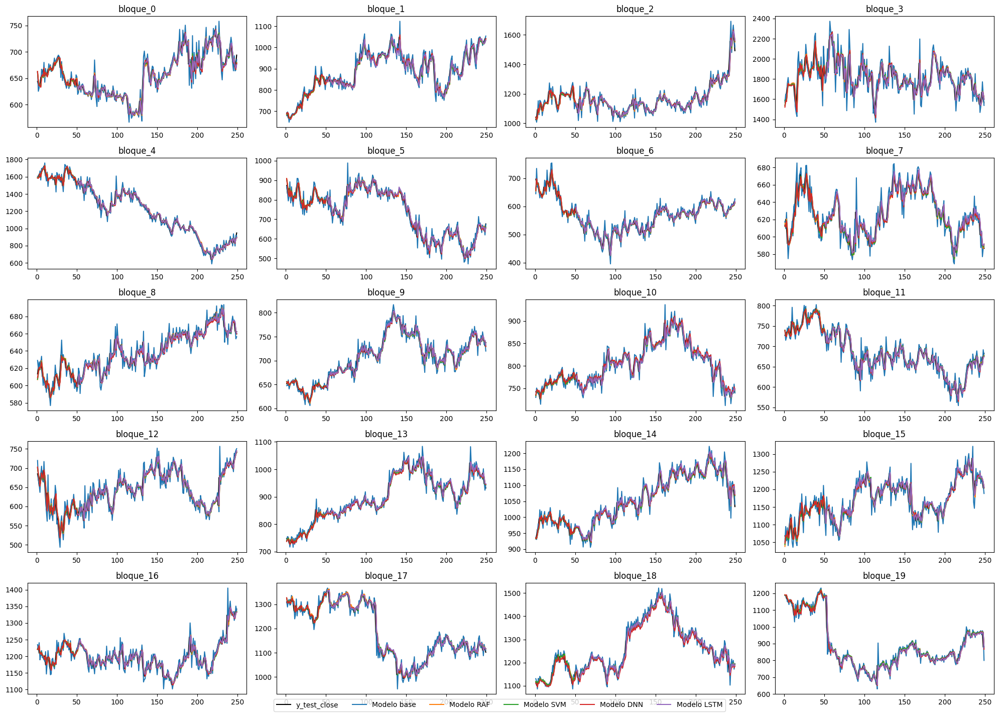

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\REL_predicciones_precio_5x4.png


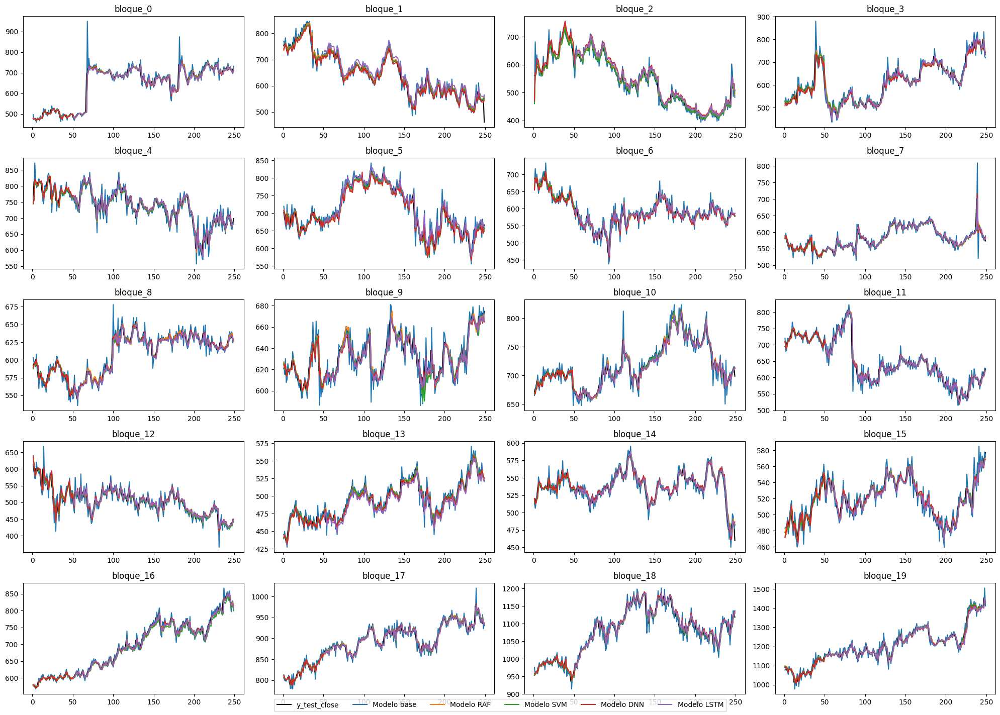

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\NWG_predicciones_precio_5x4.png


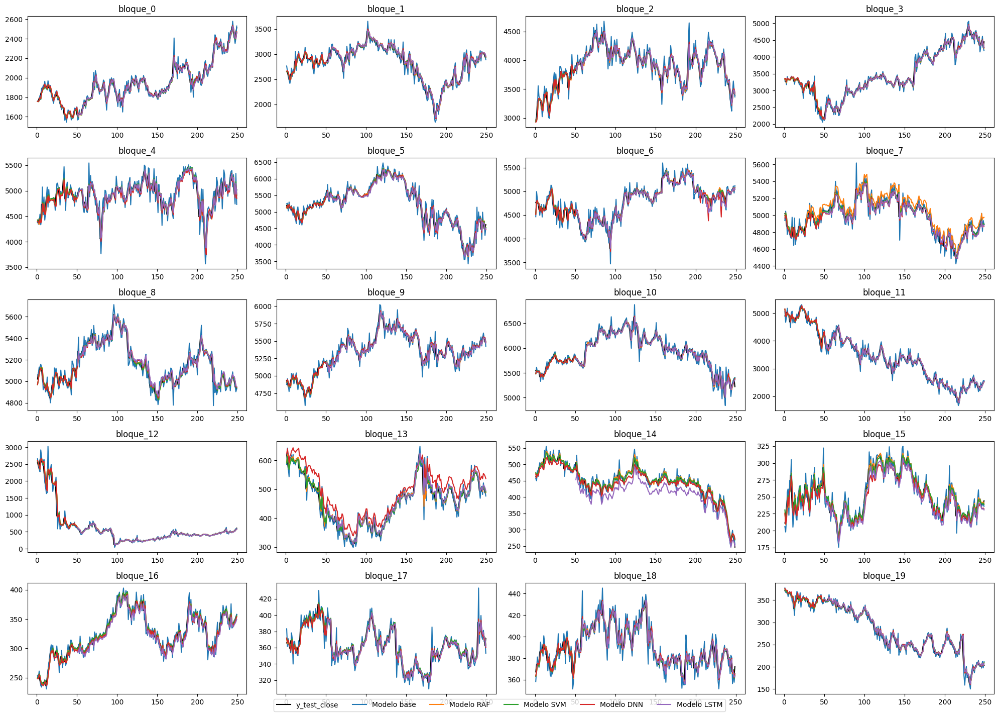

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\SHEL_predicciones_precio_5x4.png


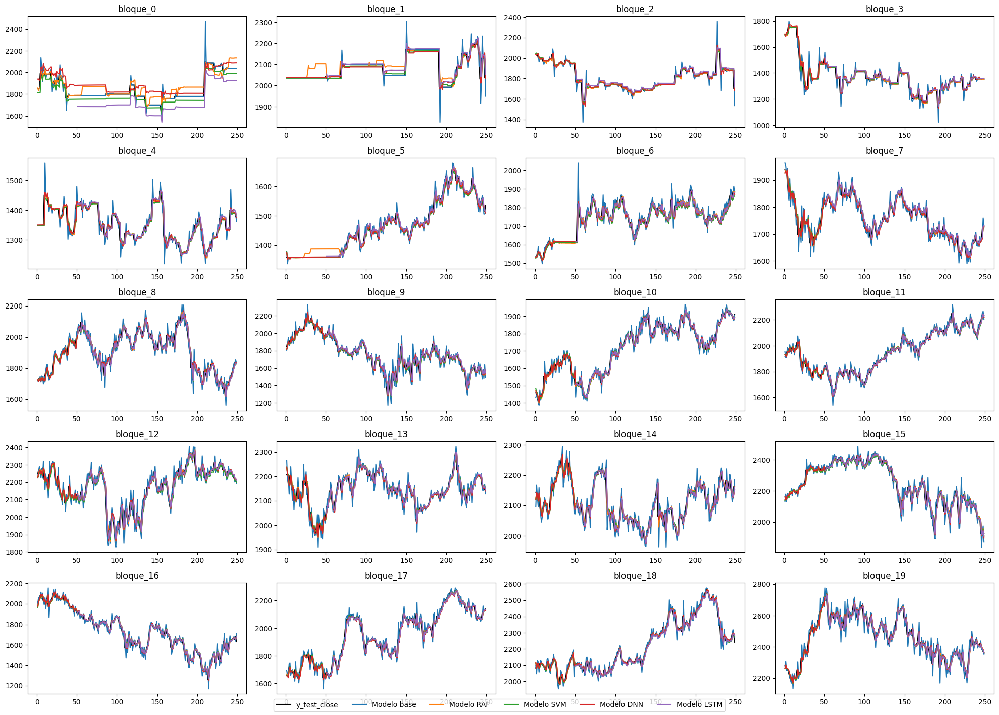

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\SGE_predicciones_precio_5x4.png


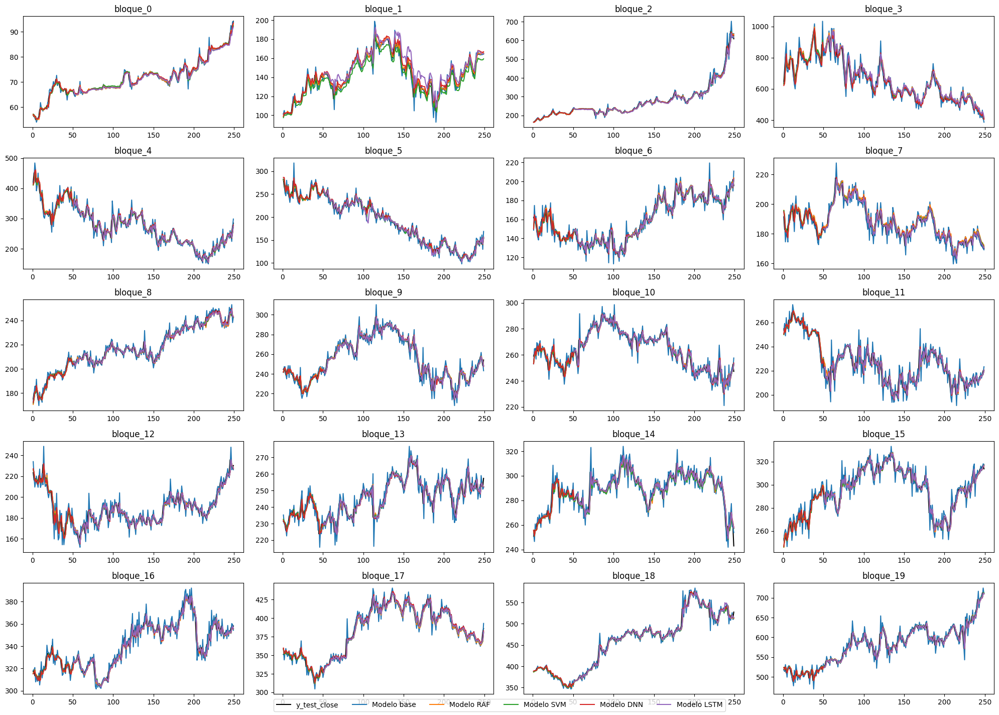

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\SBRY_predicciones_precio_5x4.png


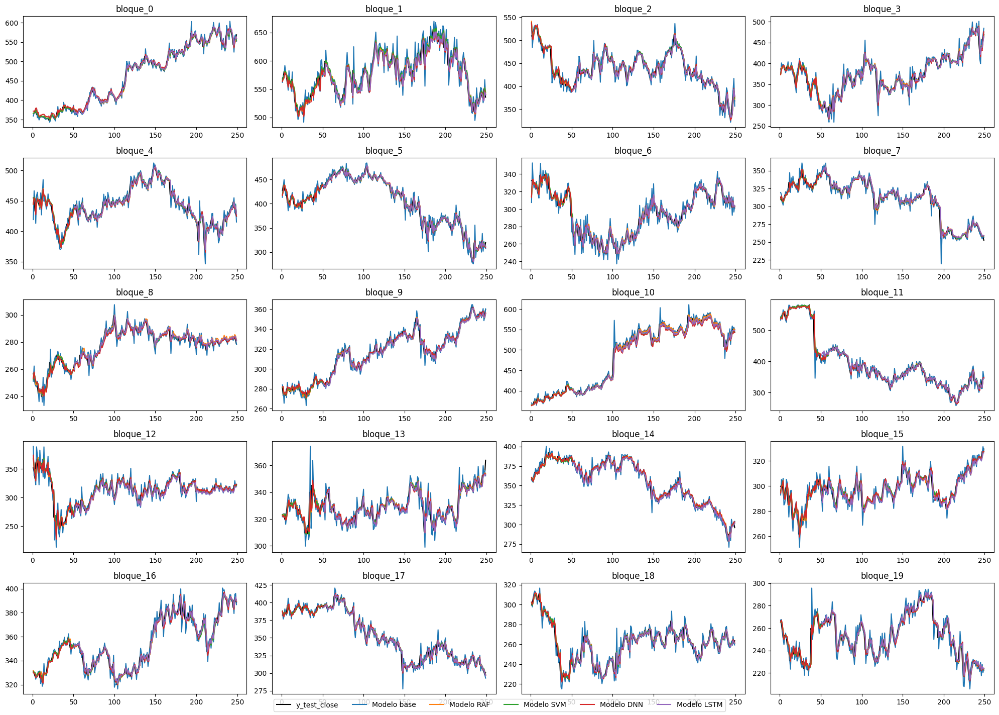

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\SDR_predicciones_precio_5x4.png


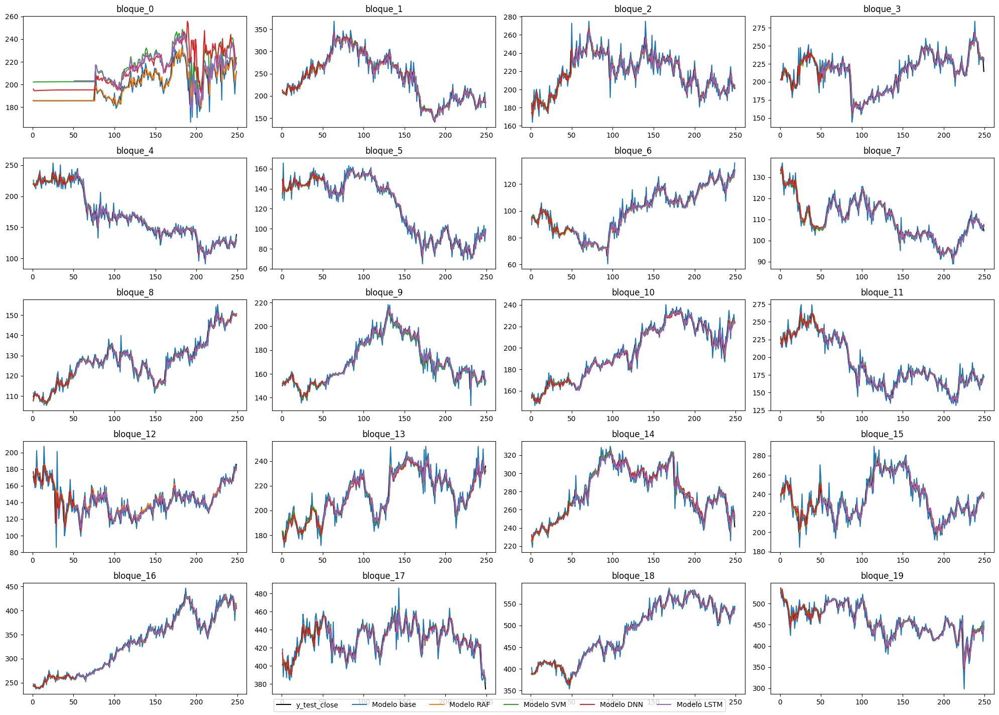

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\SVT_predicciones_precio_5x4.png


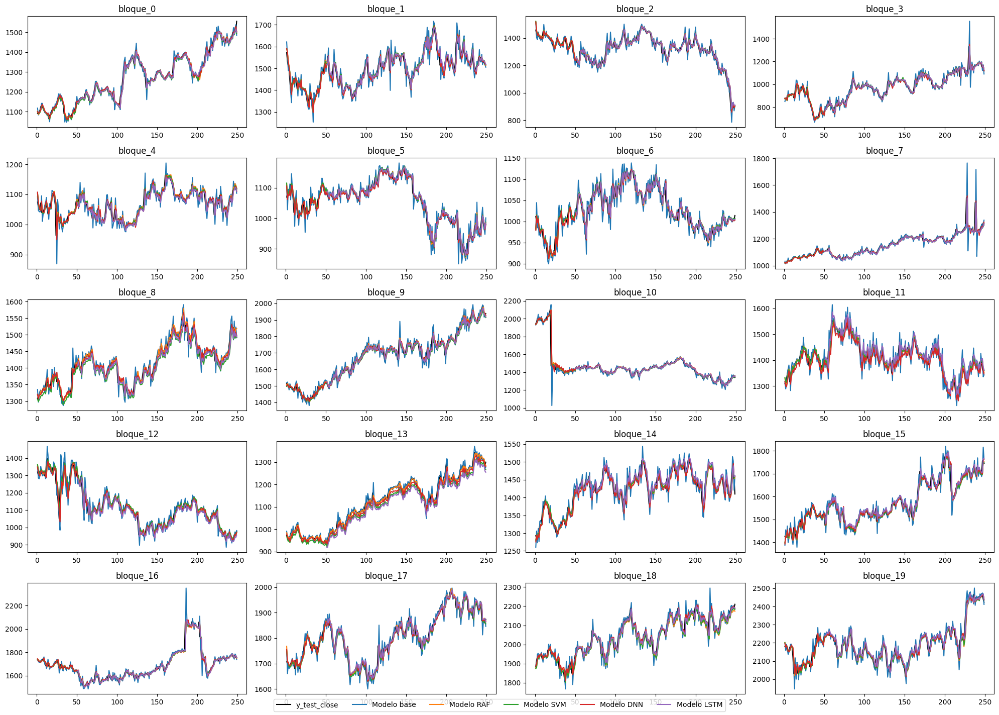

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\SMIN_predicciones_precio_5x4.png


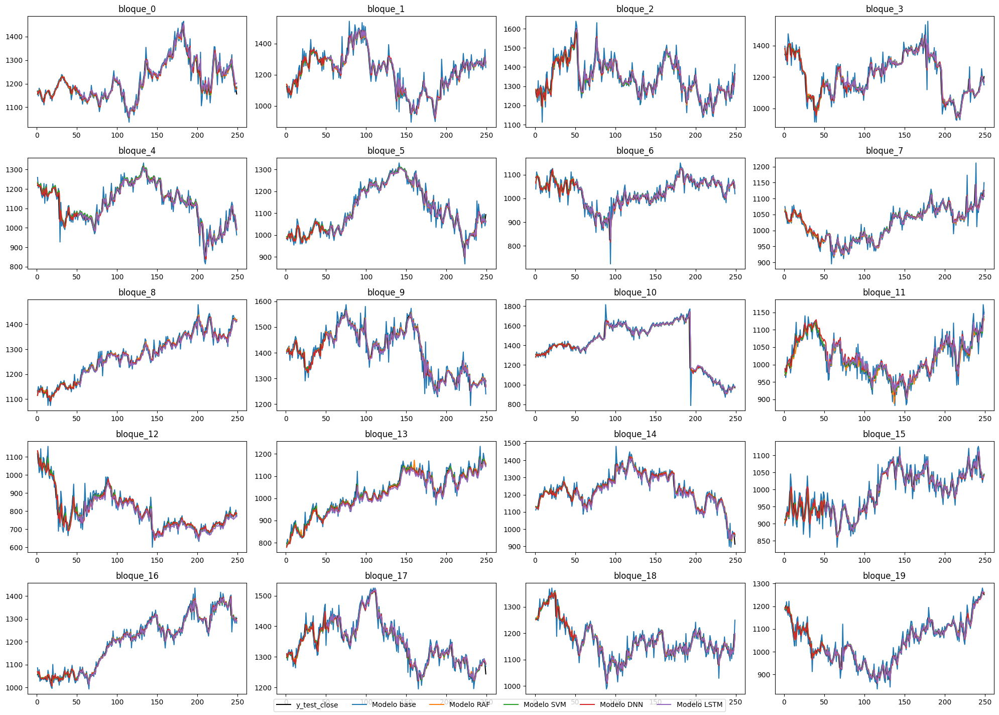

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\SSE_predicciones_precio_5x4.png


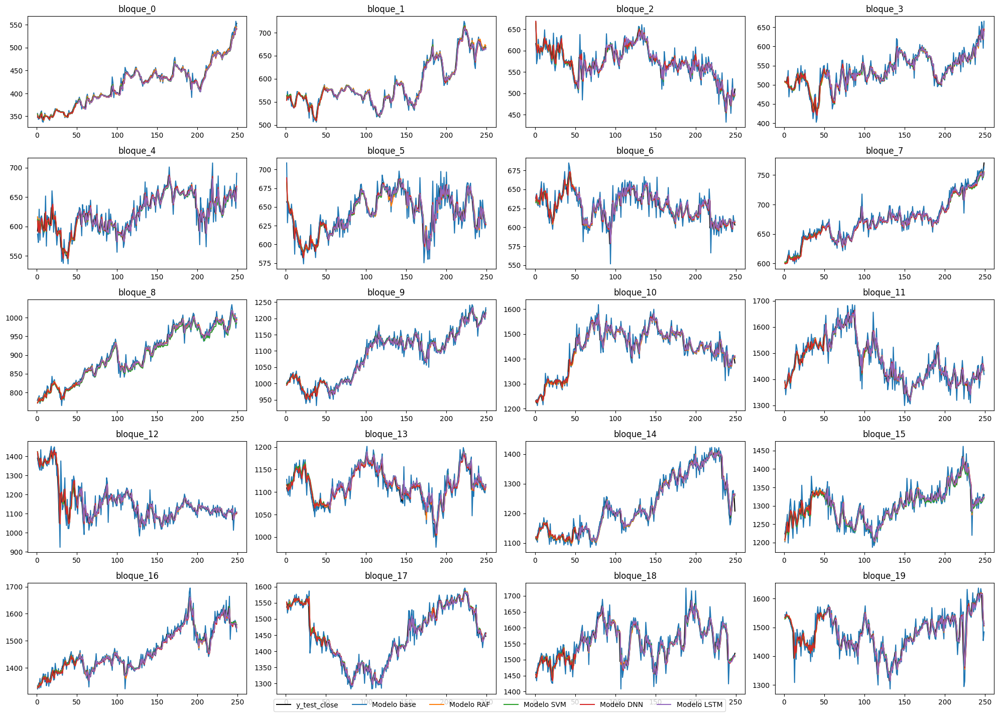

Imagen guardada en: C:\Users\Usuario\Desktop\TFM\Codigos python\imagenes\VOD_predicciones_precio_5x4.png


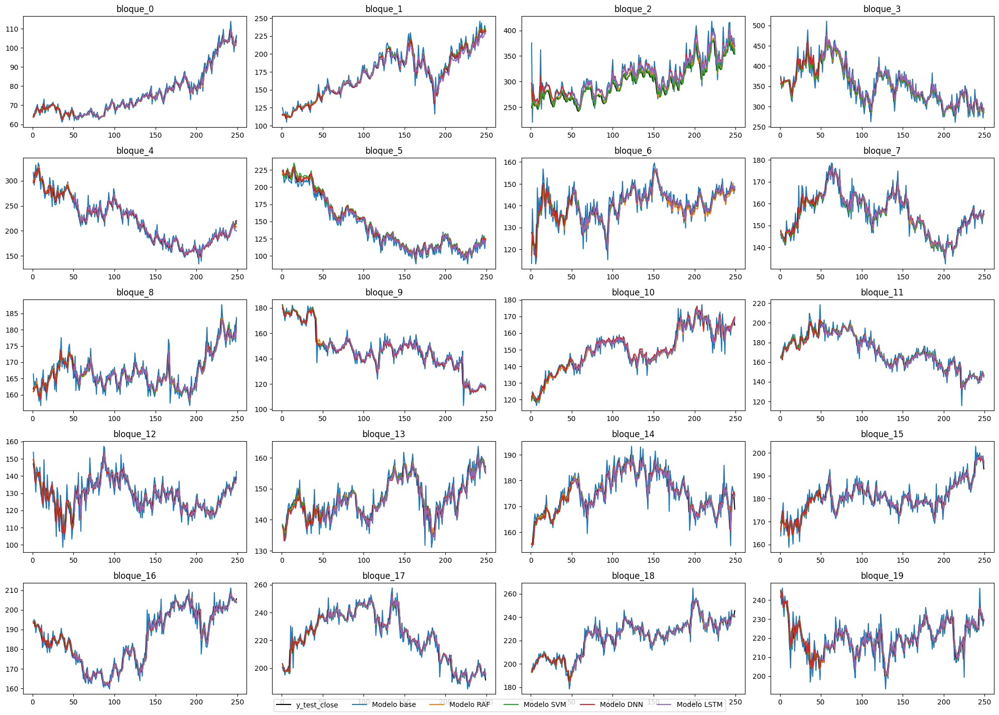

In [69]:
nombres_acciones = list(data_frames.keys())

for nombre_accion in nombres_acciones: 
    grafica_predicciones_multiple_precio(nombre_accion, models=['base','RAF','SVM', 'DNN', 'LSTM'])

## Hago tablas de metricas 



In [74]:
models = ['base','RAF', 'SVM', 'DNN', 'LSTM']

for model in models: 
    archivo = f'metricas_modelo_{model}.csv'
    
    # Guardo el y_test (común a todos los modelos)
    ruta = os.path.join(os.getcwd(), 'resultados_metricas', archivo)
    df = pd.read_csv(ruta, index_col=0)
    df_metricas = df.round(6)
    df_metricas.to_csv(f'df_metricas_{model}.csv', index=True)

df_metricas

,MSE,RMSE,MAE,R2
TSCO,0.000323,0.017325,0.013037,-0.130128
AZN,0.000339,0.017792,0.013391,-0.255866
BARC,0.001149,0.028951,0.022069,-0.389277
BP,0.000309,0.016951,0.012809,-0.082099
BATS,0.000313,0.016168,0.012212,-0.124152
HLMA,0.000308,0.017151,0.012346,-0.089537
HSBA,0.000359,0.017215,0.012950,-0.100937
JMAT,0.000419,0.019524,0.014371,-0.045320
LGEN,0.000667,0.023209,0.016990,-0.034242
MKS,0.000474,0.020805,0.015163,-0.199451


In [43]:
models = ['LSTM']

for model in models: 
    archivo = f'metricas_modelo_{model}.csv'
    
    # Guardo el y_test (común a todos los modelos)
    ruta = os.path.join(os.getcwd(), 'resultados_metricas', archivo)
    df = pd.read_csv(ruta, index_col=0)
    df_metricas = df.round(6)
    df_metricas.to_csv(f'df_metricas_{model}.csv', index=True)

df_metricas

,MSE,RMSE,MAE,R2
TSCO,0.000308,0.016792,0.012490,-0.020461
AZN,0.000296,0.016610,0.012269,-0.039100
BARC,0.001149,0.028739,0.022098,-0.383747
BP,0.000316,0.016983,0.012707,-0.036206
BATS,0.000303,0.015903,0.012053,-0.043179
HLMA,0.000368,0.017923,0.012878,-0.179603
HSBA,0.000360,0.017097,0.012733,-0.031092
JMAT,0.000425,0.019581,0.014327,-0.024181
LGEN,0.000683,0.023385,0.016958,-0.027131
MKS,0.000458,0.020234,0.014806,-0.103312


In [39]:

# MSE
mse_base  = pd.read_csv('df_metricas_base.csv', index_col=0)['MSE']
mse_arima = pd.read_csv('df_metricas_ARIMA.csv', index_col=0)['MSE']
mse_RAF   = pd.read_csv('df_metricas_RAF.csv', index_col=0)['MSE']
mse_SVM   = pd.read_csv('df_metricas_SVM.csv', index_col=0)['MSE']
mse_DNN   = pd.read_csv('df_metricas_DNN.csv', index_col=0)['MSE']
mse_LSTM  = pd.read_csv('df_metricas_LSTM.csv', index_col=0)['MSE']


# MAE
mae_base  = pd.read_csv('df_metricas_base.csv', index_col=0)['MAE']
mae_arima = pd.read_csv('df_metricas_ARIMA.csv', index_col=0)['MAE']
mae_RAF   = pd.read_csv('df_metricas_RAF.csv', index_col=0)['MAE']
mae_SVM   = pd.read_csv('df_metricas_SVM.csv', index_col=0)['MAE']
mae_DNN   = pd.read_csv('df_metricas_DNN.csv', index_col=0)['MAE']
mae_LSTM  = pd.read_csv('df_metricas_LSTM.csv', index_col=0)['MAE']



type(mse_arima)

pandas.core.series.Series

In [44]:
# MSE
df_mse = pd.concat([mse_base, mse_arima, mse_RAF, mse_SVM, mse_DNN, mse_LSTM], axis=1)
df_mse.to_csv(f'df_MSE.csv', index=True)
df_mse



,MSE,MSE,MSE,MSE,MSE,MSE
TSCO,0.000625,0.000301,0.000304,0.000302,0.000570,0.000308
AZN,0.000560,0.000290,0.000294,0.000297,0.000312,0.000296
BARC,0.001594,0.000847,0.000859,0.000863,0.000864,0.001149
BP,0.000610,0.000306,0.000309,0.000307,0.000308,0.000316
BATS,0.000594,0.000289,0.000297,0.000300,0.000299,0.000303
HLMA,0.000582,0.000289,0.000295,0.000301,0.000297,0.000368
HSBA,0.000691,0.000348,0.000353,0.000353,0.000378,0.000360
JMAT,0.000863,0.000416,0.000422,0.000434,0.000427,0.000425
LGEN,0.001388,0.000667,0.000673,0.000679,0.000699,0.000683
MKS,0.000852,0.000421,0.000446,0.000433,0.000966,0.000458


In [45]:
# MSE
df_mae = pd.concat([mae_base, mae_arima, mae_RAF, mae_SVM, mae_DNN, mae_LSTM], axis=1)
df_mae.to_csv(f'df_MAE.csv', index=True)
df_mae

,MAE,MAE,MAE,MAE,MAE,MAE
TSCO,0.017958,0.012324,0.012405,0.012370,0.016999,0.012490
AZN,0.016709,0.011985,0.012108,0.012223,0.012577,0.012269
BARC,0.025598,0.018527,0.018689,0.018889,0.018845,0.022098
BP,0.017764,0.012446,0.012559,0.012542,0.012511,0.012707
BATS,0.016838,0.011586,0.011802,0.011922,0.011835,0.012053
HLMA,0.016687,0.011462,0.011788,0.012127,0.011950,0.012878
HSBA,0.018170,0.012485,0.012624,0.012608,0.013420,0.012733
JMAT,0.020484,0.014109,0.014336,0.014495,0.014439,0.014327
LGEN,0.024455,0.016717,0.016919,0.017080,0.017395,0.016958
MKS,0.020265,0.013996,0.014398,0.014300,0.020803,0.014806
